<a href="https://colab.research.google.com/github/Sneha-Mahata/Dog-Vision/blob/main/Dog_Vision_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🐶 End-to-end Multi-class Dog Breed Classification

This notebook builds an end-to-end multi-class image classifier using Tensorflow 2.0 and Tensorflow Hub.

## 1. Problem

Identifying the breed of a dog given an image of a dog.

When I'm sitting at the cafe and take a photo of a dog , I want to know what breed of dog it is.

## 2. Data

The data which is being used is from Kaggle's dog breed identification competition.

https://www.kaggle.com/c/dog-breed-identification/data

## 3. Evaluation

The evaluation is a file with prediction probabilities for each dog breed of each test image.

https://www.kaggle.com/c/dog-breed-identification/overview

## 4. Features

Some informations about the data:
* As dealing with images (unstructured data) so it's probably best to use deep learning/transfer learning.
* There are 120 breeds of dogs (this means there are 120 different classes).
* There are around 10,000+ images in the training set (these images have labels).
* There are around 10,000+ images in the test set (these images have no labels, because we'll want to predict them).

In [1]:
# Unzip the uploaded data into Google Drive
# !unzip "drive/My Drive/Dog-Vision-Project/dog-breed-identification.zip" -d "drive/My Drive/Dog-Vision-Project/"

### Get Workplace ready

* Import Tensorflow 2.x ✅
* Import Tensorflow Hub ✅
* Make sure we're using a GPU ✅


In [2]:
# Import Necessary Tools
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("TF Hub version:", hub.__version__)

# Check for GPU availability
print("GPU", "available (YESSSS!!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

TF version: 2.15.0
TF Hub version: 0.15.0
GPU available (YESSSS!!!!!)


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Getting Data ready (turning into Tensors)

With all machine learning models, the data has to be in numerical format. So that's what must be done first. Turning the images into Tensors (numerical representations).

Let's start by accessing the data and checking out the labels.

In [5]:
# Check out the labels of the data
import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/Dog-Vision-Project/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [6]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


<Axes: >

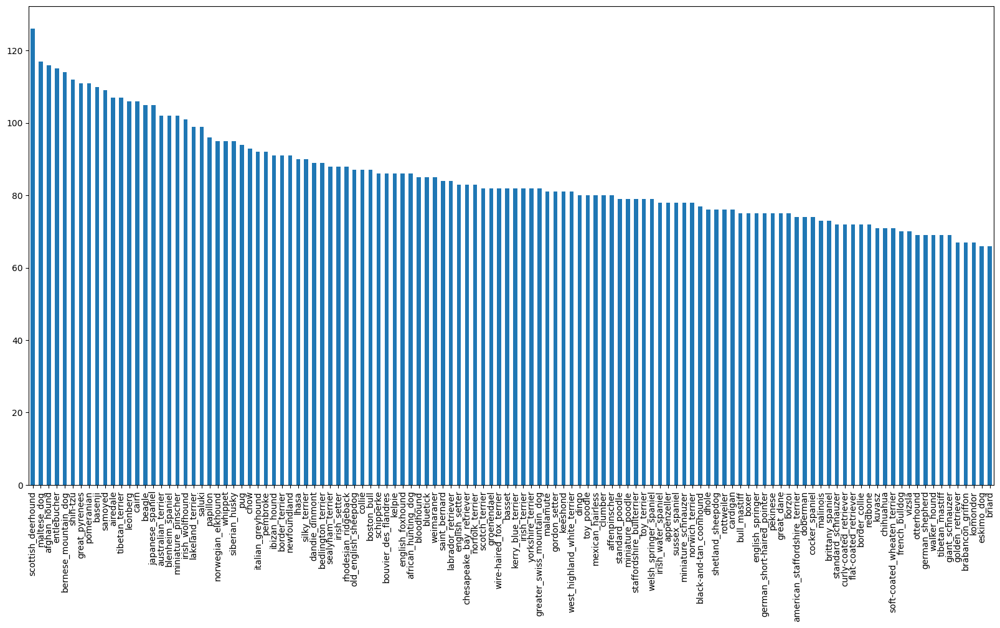

In [7]:
# How many images are there for each breed?
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10))

In [8]:
labels_csv["breed"].value_counts().median()

82.0

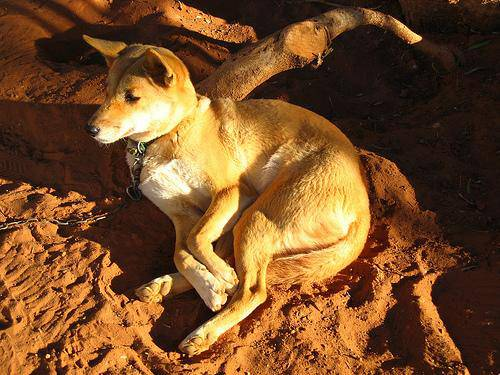

In [9]:
# Let's view an image
from IPython.display import Image
Image("drive/MyDrive/Dog-Vision-Project/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

### Getting images and their labels

Since we've got the image ID's and their labels in a DataFrame (`labels_csv`), we'll use it to create:
* A list a filepaths to training images
* An array of all labels
* An array of all unique labels

We'll only create a list of filepaths to images rather than importing them all to begin with. This is because working with filepaths (strings) is much efficient than working with images.

In [10]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [11]:
# Create pathnames from image ID's
filenames = ["drive/MyDrive/Dog-Vision-Project/train/" + fname + ".jpg" for fname in labels_csv["id"]]
# Check the first 10
filenames[:10]


['drive/MyDrive/Dog-Vision-Project/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog-Vision-Project/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

Now we've got a list of all the filenames from the ID column of `labels_csv`, we can compare it to the number of files in our training data directory to see if they line up.

If they do, great. If not, there may have been an issue when unzipping the data (what we did above), to fix this, you might have to unzip the data again. Be careful not to let your Colab notebook disconnect whilst unzipping.

In [12]:
# Check whether number of filenames matches number of actual image files
import os
if len(os.listdir("drive/My Drive/Dog-Vision-Project/train/")) == len(filenames):
    print("Filenames match actual amount of files!!! Proceed")
else:
    print("Filenames do not match actual amount of files, check the target directory.")

Filenames match actual amount of files!!! Proceed


Let's do one more check. Visualizing directly from a filepath.

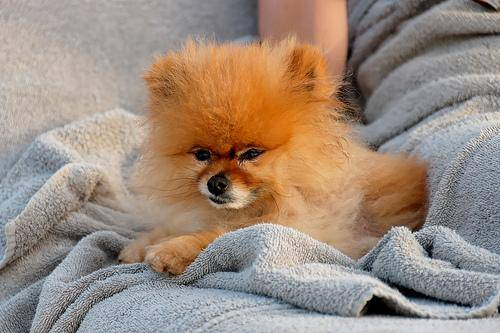

In [13]:
# Check an image directly from a filepath
Image(filenames[8000])

In [14]:
labels_csv["breed"][8000]

'pomeranian'

Since the training image filepaths in a list is got, let's prepare the labels.

In [15]:
import numpy as np
labels = labels_csv["breed"].to_numpy() # convert labels column to NumPy array
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

In [16]:
len(labels)

10222

In [17]:
# See if number of labels matches the number of filenames
if len(labels) == len(filenames):
    print("Number of labels matches number of filenames!")
else:
    print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


Finally, since a machine learning model can't take strings as input (what labels currently is), we'll have to convert our labels to numbers.

To begin with, we'll find all of the unique dog breed names.

Then we'll go through the list of labels and compare them to unique breeds and create a list of booleans indicating which one is the real label (True) and which ones aren't (False).

In [18]:
# Find the unique label values
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [19]:
len(unique_breeds)

120

Now use `unique_breeds` to help turn our `labels` array into an array of booleans.

In [20]:
# Example: Turn one label into an array of booleans
print(labels[0])
labels[0] == unique_breeds # use comparison operator to create boolean array

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

That's for one example, let's do the whole thing.

In [21]:
len(labels)

10222

In [22]:
# Turn every label into a boolean array and make a list of those boolean arrays
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [23]:
labels[:2]

array(['boston_bull', 'dingo'], dtype=object)

In [24]:
len(boolean_labels)

10222

Why do it like this?

Remember, an important concept in machine learning is converting your data to numbers before passing it to a machine learning model.

In this case, we've transformed a single dog breed name such as boston_bull into a one-hot array.

Let's see an example.

In [25]:
# Example: Turning a boolean array into integers
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])[0][0]) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [26]:
print(labels[2])
print(boolean_labels[2].astype(int))

pekinese
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating my own Validation Set

Since the dataset from Kaggle doesn't come with a validation set (a split of the data I can test our model on before making final predicitons on the test set), let's make one.

I could use Scikit-Learn's [train_test_split](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html) function or I could simply make manual splits of the data.

For accessibility later, let's save my filenames variable to `X` (data) and our labels to `y`.

In [27]:
# Setup X & y variables
X = filenames
y = boolean_labels

In [28]:
len(X), len(y)

(10222, 10222)

Since working with 10,000+ images, it's a good idea to work with a portion of them to make sure things are working before training on them all.

This is because computing with 10,000+ images could take a fairly long time. And the goal when working through machine learning projects is to reduce the time between experiments.

Starting experimenting with 1000 and increasing it as needed.

In [29]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

Splitting data into training and validation sets. Using and 80/20 split (80% training data, 20% validation data).

In [30]:
# Import train_test_split from Scikit-Learn
from sklearn.model_selection import train_test_split

# Split them into training and validation using NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [31]:
# Checking out the training data (image file paths and labels)
X_train[:5], y_train[:2]

(['drive/MyDrive/Dog-Vision-Project/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog-Vision-Project/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/MyDrive/Dog-Vision-Project/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/MyDrive/Dog-Vision-Project/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/MyDrive/Dog-Vision-Project/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, Fa

### Preprocessing images (turning images into Tensors)

Our labels are in numeric format but our images are still just file paths.

Since we're using TensorFlow, our data has to be in the form of Tensors.

A Tensor is a way to represent information in numbers. If you're familar with NumPy arrays (you should be), a Tensor can be thought of as a combination of NumPy arrays, except with the special ability to be used on a GPU.

Because of how TensorFlow stores information (in Tensors), it allows machine learning and deep learning models to be run on GPUs (generally faster at numerical computing).

To preprocess our images into Tensors we're going to write a function which does a few things:
1. Takes an image filename as input.
2. Uses TensorFlow to read the file and save it to a variable, `image`.
3. Turn our `image` (a jpeg file) into Tensors.
4. Normalize the `image` (convert color channels values from 0-255 to 0-1).
5. Resize the `image` to be of shape (224, 224).
6. Return the modified `image`.

A good place to read about this type of function is the [TensorFlow documentation on loading images](https://www.tensorflow.org/tutorials/load_data/images).

You might be wondering why (224, 224), which is (heigh, width). It's because this is the size of input our model (we'll see this soon) takes, an image which is (224, 224, 3).

What? Where's the 3 from? We're getting ahead of ourselves but that's the number of colour channels per pixel, red, green and blue.

Let's make this a little more concrete.


In [32]:
# Convert image to NumPy array
from matplotlib.pyplot import imread # imread = image read
image = imread(filenames[42]) # read in an image
image.shape

(257, 350, 3)

Notice the shape of `image`. It's (257, 350, 3). This is height, width, colour channel value.

And we can easily convert it to a Tensor using [`tf.constant()`](https://www.tensorflow.org/api_docs/python/tf/constant).

In [33]:
image.max(), image.min()

(255, 0)

In [34]:
image[:2]

array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)

In [35]:
# Turn image into a tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

Ok, now let's build that function we were talking about.

In [36]:
# Define image size
IMG_SIZE = 224

def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE,IMG_SIZE])
  return image

### Creating Databatches

Now creating the function to convert the images into Tensors is done, now building one to turn the data into batches (more specifically, a TensorFlow [`BatchDataset`](https://www.tensorflow.org/guide/data#batching_dataset_elements)).

What's a batch?

A batch (also called mini-batch) is a small portion of the data, say 32 (32 is generally the default batch size) images and their labels. In deep learning, instead of finding patterns in an entire dataset at the same time, we'll often find them one batch at a time.

Let's say we're dealing with 10,000+ images (which we are). Together, these files may take up more memory than the GPU has. Trying to compute on them all would result in an error.

Instead, it's more efficient to create smaller batches of the data and compute on one batch at a time.

TensorFlow is very efficient when the data is in batches of (image, label) Tensors. So we'll build a function to do create those first. We'll take advantage of of `process_image` function at the same time.

Now in order to use Tensorflow effectively, we need the data in the form of Tensor tuples which look like this: `(image, label)`


In [37]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

Let's make a function to turn all the data (X & y) into batches!

In [38]:
# Define the batch size, 32 is a good default
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """

  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE) # process the image and turn into a batch of BATCH_SIZE
    return data_batch

  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),  # filepaths
                                                tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  # If the data is a training dataset, we shuffle it
  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),  # filename
                                               tf.constant(y))) # labels
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))
    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)
    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
    return data_batch

In [39]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [40]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

We've got our data in batches, more specifically, they're in Tensor pairs of (images, labels) ready for use on a GPU.

### Visualizing data batches

The data is now in batches, however, this can be a little hard to understand/comprehend, let's visualize them!

In [41]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range (25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1) # rows = 5, cols = 5, index = i+1
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

To make computation efficient, a batch is a tighly wound collection of Tensors.

So to view data in a batch, we've got to unwind it.

We can do so by calling the [`as_numpy_iterator()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#as_numpy_iterator) method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to [`next()`](https://docs.python.org/3/library/functions.html#next) will return the next item in the iterator.

In our case, next will return a batch of 32 images and label pairs.

In [42]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [43]:
train_images, train_labels = next(train_data.as_numpy_iterator())
train_images, train_labels

(array([[[[0.204582  , 0.22811142, 0.18889572],
          [0.257496  , 0.275038  , 0.23382652],
          [0.26758245, 0.27934715, 0.23620988],
          ...,
          [0.2817052 , 0.2071954 , 0.18366598],
          [0.27785352, 0.20526956, 0.18559182],
          [0.2708747 , 0.20028648, 0.18460019]],
 
         [[0.20964934, 0.23317875, 0.19396307],
          [0.24982956, 0.26737157, 0.2261601 ],
          [0.2510754 , 0.2628401 , 0.21970281],
          ...,
          [0.27450982, 0.20000002, 0.1764706 ],
          [0.27161247, 0.19855134, 0.1788736 ],
          [0.26941675, 0.19785689, 0.1821706 ]],
 
         [[0.1747832 , 0.19831263, 0.15909693],
          [0.2003987 , 0.21794072, 0.17672923],
          [0.18828994, 0.20005465, 0.1569174 ],
          ...,
          [0.27637503, 0.20186523, 0.1783358 ],
          [0.27854386, 0.20403408, 0.18435633],
          [0.2826243 , 0.2081145 , 0.19242822]],
 
         ...,
 
         [[0.63455904, 0.62279433, 0.44632372],
          [0.68670

In [44]:
len(train_images), len(train_labels)

(32, 32)

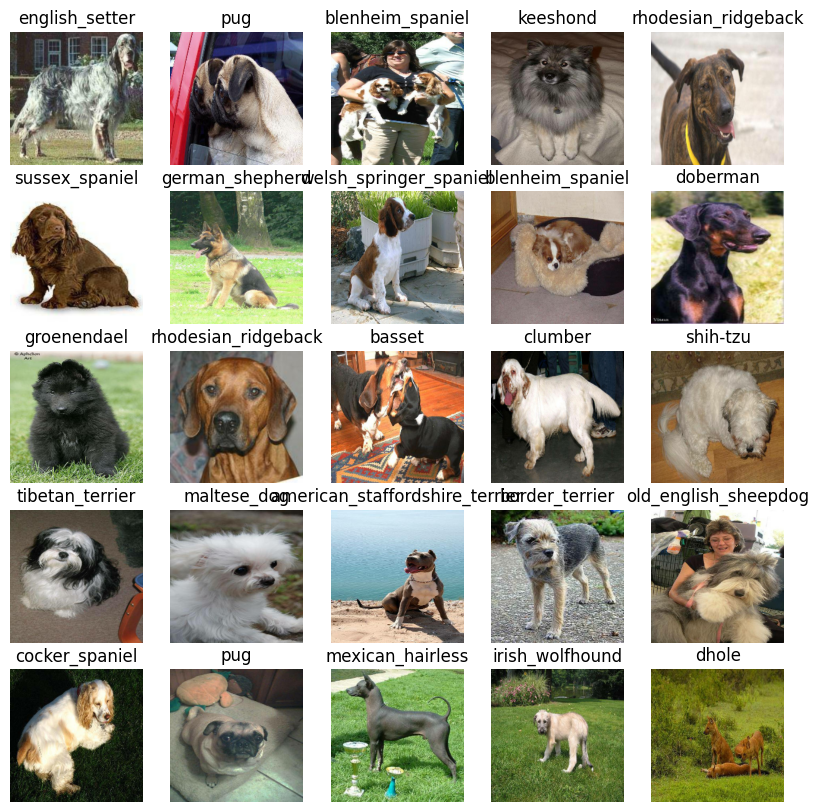

In [45]:
# Visualize training images from the training data batch
show_25_images(train_images, train_labels)

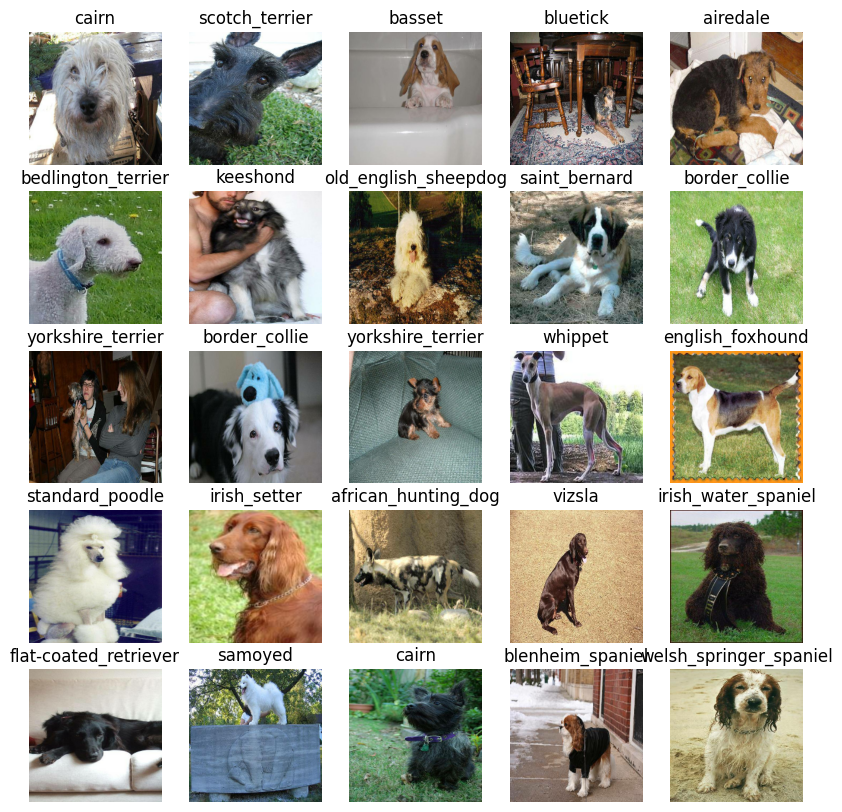

In [46]:
# Visualize validation images from the validation data batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Creating and training a model

Now our data is ready, let's prepare it modelling. We'll use an existing model from [TensorFlow Hub](https://tfhub.dev/).

TensorFlow Hub is a resource where you can find pretrained machine learning models for the problem you're working on.

Using a pretrained machine learning model is often referred to as **transfer learning**.

#### Why use a pretrained model?

Building a machine learning model and training it on lots from scratch can be expensive and time consuming.

Transfer learning helps eliviate some of these by taking what another model has learned and using that information with your own problem.

#### How do we choose a model?

Since we know our problem is image classification (classifying different dog breeds), we can navigate the [TensorFlow Hub page by our problem domain (image)](https://tfhub.dev/s?module-type=image-augmentation,image-classification,image-feature-vector,image-generator,image-object-detection,image-others,image-style-transfer,image-rnn-agent).

We start by choosing the image problem domain, and then can filter it down by subdomains, in our case, [image classification](https://tfhub.dev/s?module-type=image-classification).

Doing this gives a list of different pretrained models we can apply to our task.

Clicking on one gives us information about the model as well as instructions for using it.

For example, clicking on the [mobilenet_v2_130_224](https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4) model, tells us this model takes an input of images in the shape 224, 224. It also says the model has been trained in the domain of image classification.

Let's try it out.

### Building a model

Before we build a model, there are a few things we need to define:
* The input shape (images, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use.

These things will be standard practice with whatever machine learning model you use. And because we're using TensorFlow, everything will be in the form of Tensors.


In [47]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

Now we've got the inputs, outputs and model we're using ready to go. We can start to put them together

There are many ways of building a model in TensorFlow but one of the best ways to get started is to [use the Keras API](https://www.tensorflow.org/guide/keras/overview).

Defining a deep learning model in Keras can be as straightforward as saying, "here are the layers of the model, the input shape and the output shape, let's go!"

Knowing this, let's create a function which:
* Takes the input shape, output shape and the model we've chosen's URL as parameters.
* Defines the layers in a Keras model in a sequential fashion (do this first, then this, then that).
* Compiles the model (says how it should be evaluated and improved).
* Builds the model (tells it what kind of input shape it'll be getting).
* Returns the model.

In [48]:
# Create a function which builds a Keras model
def create_model(input_shape = INPUT_SHAPE, output_shape = OUTPUT_SHAPE, model_url = MODEL_URL):
  print("Building model with: ", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
      hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
      tf.keras.layers.Dense(units = OUTPUT_SHAPE,
                            activation = "softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer = tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics = ["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

What's happening here?

#### Setting up the model layers

There are two ways to do this in Keras, the [functional](https://www.tensorflow.org/guide/keras/functional) and [sequential API](https://www.tensorflow.org/guide/keras/overview#build_a_simple_model). We've used the sequential.

Which one should you use?

The Keras documentation states the functional API is the way to go for defining complex models but the sequential API (a linear stack of layers) is perfectly fine for getting started, which is what we're doing.

The first layer we use is the model from TensorFlow Hub (`hub.KerasLayer(MODEL_URL)`). So our first layer is actually an entire model (many more layers). This **input layer** takes in our images and finds patterns in them based on the patterns [`mobilenet_v2_130_224`](https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4) has found.

The next layer (`tf.keras.layers.Dense()`) is the **output layer** of our model. It brings all of the information discovered in the input layer together and outputs it in the shape we're after, 120 (the number of unique labels we have).

The `activation="softmax"` parameter tells the output layer, we'd like to assign a probability value to each of the 120 labels [somewhere between 0 & 1](https://en.wikipedia.org/wiki/Softmax_function). The higher the value, the more the model believes the input image should have that label. If we were working on a binary classification problem, we'd use `activation="sigmoid"`.

For more on which activation function to use, see the article [Which Loss and Activation Functions Should I Use](https://towardsdatascience.com/deep-learning-which-loss-and-activation-functions-should-i-use-ac02f1c56aa8)?

#### Compiling the model

This one is best explained with a story.

Let's say you're at the international hill descending championships. Where your start standing on top of a hill and your goal is to get to the bottom of the hill. The catch is you're blindfolded.

Luckily, your friend Adam is standing at the bottom of the hill shouting instructions on how to get down.

At the bottom of the hill there's a judge evaluating how you're doing. They know where you need to end up so they compare how you're doing to where you're supposed to be. Their comparison is how you get scored.

Transferring this to `model.compile()` terminology:
* `loss` - The height of the hill is the loss function, the models goal is to minimize this, getting to 0 (the bottom of the hill) means the model is learning perfectly.
* `optimizer` - Your friend Adam is the optimizer, he's the one telling you how to navigate the hill (lower the loss function) based on what you've done so far. His name is Adam because the [Adam optimizer](https://machinelearningmastery.com/adam-optimization-algorithm-for-deep-learning/) is a great general which performs well on most models. Other optimizers include [RMSprop](https://ruder.io/optimizing-gradient-descent/index.html#rmsprop) and [Stochastic Gradient Descent](https://en.wikipedia.org/wiki/Stochastic_gradient_descent).
* `metrics` - This is the onlooker at the bottom of the hill rating how well your perfomance is. Or in our case, giving the accuracy of how well our model is predicting the correct image label.

#### Building the model

We use `model.build()` whenever we're using a layer from TensorFlow Hub to tell our model what input shape it can expect.

In this case, the input shape is `[None, IMG_SIZE, IMG_SIZE, 3]` or `[None, 224, 224, 3]` or `[batch_size, img_height, img_width, color_channels]`.

Batch size is left as `None` as this is inferred from the data we pass the model. In our case, it'll be 32 since that's what we've set up our data batches as.

Now we've gone through each section of the function, let's use it to create a model.

We can call `summary()` on our model to get idea of what our model looks like.

In [49]:
# Create a model and check its details
model = create_model()
# Show the model architecture
model.summary()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


The non-trainable parameters are the patterns learned by `mobilenet_v2_130_224` and the trainable parameters are the ones in the dense layer we added.

This means the main bulk of the information in our model has already been learned and we're going to take that and adapt it to our own problem.

#### Creating callbacks

We've got a model ready to go but before we train it we'll make some callbacks.

Callbacks are helper functions a model can use during training to do things such as save a models progress, check a models progress or stop training early if a model stops improving.

The two callbacks we're going to add are a TensorBoard callback and an Early Stopping callback.



##### TensorBoard Callback

[TensorBoard](https://www.tensorflow.org/tensorboard/get_started) helps provide a visual way to monitor the progress of your model during and after training.

It can be used [directly in a notebook](https://www.tensorflow.org/tensorboard/tensorboard_in_notebooks) to track the performance measures of a model such as loss and accuracy.

To set up a TensorBoard callback and view TensorBoard in a notebook, we need to do three things:
1. Load the TensorBoard notebook extension. ✅
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function. ✅
3. Visualize the our models training logs using the `%tensorboard` magic function (we'll do this later on). ✅

In [50]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [51]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/My Drive/Dog-Vision-Project/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)


##### Early Stopping Callback

[Early stopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) helps prevent overfitting by stopping a model when a certain evaluation metric stops improving. If a model trains for too long, it can do so well at finding patterns in a certain dataset that it's not able to use those patterns on another dataset it hasn't seen before (doesn't generalize).

It's basically like saying to our model, "keep finding patterns until the quality of those patterns starts to go down."


In [52]:
# Create early stopping (once our model stops improving, stop training)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor = "val_accuracy",
                                                  patience = 3) # stops after 3 rounds of no improvements

#### Training a model (on a subset of data)
Our first model is only going to be trained on 1000 images. Or trained on 800 images and then validated on 200 images, meaning 1000 images total or about 10% of the total data.

We do this to make sure everything is working. And if it is, we can step it up later and train on the entire training dataset.

The final parameter we'll define before training is `NUM_EPOCHS` (also known as **number of epochs**).

`NUM_EPOCHS` defines how many passes of the data we'd like our model to do. A pass is equivalent to our model trying to find patterns in each dog image and see which patterns relate to each label.

If `NUM_EPOCHS=1`, the model will only look at the data once and will probably score badly because it hasn't a chance to correct itself. It would be like you competing in the international hill descent championships and your friend Adam only being able to give you 1 single instruction to get down the hill.

What's a good value for `NUM_EPOCHS`?

This one is hard to say. 10 could be a good start but so could 100. This is one of the reasons we created an early stopping callback. Having early stopping setup means if we set `NUM_EPOCHS` to 100 but our model stops improving after 22 epochs, it'll stop training.

In [53]:
# How many rounds should we get the model to look through the data?
NUM_EPOCHS = 100 #@param {type: "slider", min: 10, max: 100, step: 10}

Let's create a simple function which trains a model. The function will:
* Create a model using `create_model()`.
* Setup a TensorBoard callback using `create_tensorboard_callback()` (we do this here so it creates a log directory of the current date and time).
* Call the `fit()` function on our model passing it the training data, validatation data, number of epochs to train for and the callbacks we'd like to use.
* Return the fitted model.

In [54]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x = train_data,
            epochs = NUM_EPOCHS,
            validation_data = val_data,
            validation_freq = 1, # check validation metrics every epoch
            callbacks = [tensorboard, early_stopping])

  return model

**Note:** When training a model for the first time, the first epoch will take a while to load compared to the rest. This is because the model is getting ready and the data is being initialised. Using more data will generally take longer, which is why we've started with ~1000 images. After the first epoch, subsequent epochs should take a few seconds.

In [55]:
# Fit the model to the data
model = train_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 163s 6s/step - loss: 4.5872 - accuracy: 0.1000 - val_loss: 3.4342 - val_accuracy: 0.1850
Epoch 2/100
25/25 [==============================] - 4s 161ms/step - loss: 1.6261 - accuracy: 0.6825 - val_loss: 2.2192 - val_accuracy: 0.4850
Epoch 3/100
25/25 [==============================] - 2s 88ms/step - loss: 0.5659 - accuracy: 0.9287 - val_loss: 1.6653 - val_accuracy: 0.6000
Epoch 4/100
25/25 [==============================] - 2s 92ms/step - loss: 0.2512 - accuracy: 0.9850 - val_loss: 1.4913 - val_accuracy: 0.6250
Epoch 5/100
25/25 [==============================] - 2s 97ms/step - loss: 0.1469 - accuracy: 0.9962 - val_loss: 1.4153 - val_accuracy: 0.6650
Epoch 6/100
25/25 [==============================] - 2s 95ms/step - loss: 0.0998 - accuracy: 0.9987 - val_loss: 1.3648 - val_accuracy: 0.6600
Epoch 7/100
25/25 [==============================] - 

**Question:** It looks like our model might be overfitting (getting far better results on the training set than the validation set), what are some ways to prevent model overfitting? Hint: this may involve searching something like "ways to prevent overfitting in a deep learning model?".

**Note:** Overfitting to begin with is a good thing. It means our model is learning something.

##### Checking the TensorBoard logs
Now our model has been trained, we can make its performance visual by checking the TensorBoard logs.

The TensorBoard magic function (`%tensorboard`) will access the logs directory we created earlier and visualize its contents.

In [56]:
%tensorboard --logdir drive/My\ Drive/Dog-Vision-Project/logs

<IPython.core.display.Javascript object>

Thanks to the `early_stopping` callback, the model stopped training after 17 or so epochs (in this case). This is because the validation accuracy failed to improve for 3 epochs.

But the good news is, we can definitely see our model is learning something. The validation accuracy got to 65% in only a few minutes.

This means, if we were to scale up the number of images, hopefully we'd see the accuracy increase.

### Making and evaluating predictions using a trained model

Before we scale up and train on more data, let's see some other ways we can evaluate our model. Because although accuracy is a pretty good indicator of how our model is doing, it would be even better if we could see it in action.

Making predictions with a trained model is as calling `predict()` on it and passing it data in the same format the model was trained on.

In [57]:
# Make predictions on the validation data (not used to train on)
predictions = model.predict(val_data, verbose = 1) # verbose shows us how long there is to go

predictions

7/7 [==============================] - 1s 75ms/step


array([[4.46465611e-03, 1.13112699e-04, 3.81245452e-04, ...,
        5.23346127e-04, 5.73034267e-05, 1.70063227e-02],
       [2.65006558e-03, 1.41936156e-03, 3.21293361e-02, ...,
        1.79943675e-03, 1.42996584e-03, 8.58974701e-04],
       [3.68372230e-06, 1.53663670e-04, 7.89951737e-05, ...,
        2.27209912e-05, 1.30751450e-05, 1.82585092e-04],
       ...,
       [1.33905605e-05, 2.83599838e-05, 2.00545750e-04, ...,
        1.43378405e-04, 2.71986617e-04, 5.96375728e-04],
       [2.76113930e-03, 2.57062435e-04, 3.34668061e-04, ...,
        4.77051799e-04, 8.47794072e-05, 7.61851994e-03],
       [3.89752182e-04, 1.74912002e-05, 8.32837424e-04, ...,
        3.40192416e-03, 3.69907910e-04, 2.93649966e-04]], dtype=float32)

In [58]:
predictions.shape

(200, 120)

In [59]:
len(y_val), len(unique_breeds)

(200, 120)

Making predictions with our model returns an array with a different value for each label.

In this case, making predictions on the validation data (200 images) returns an array (`predictions`) of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

Let's see how we'd convert an array of probabilities into an actual label.

In [60]:
predictions[56]

array([6.74924720e-03, 3.68679139e-05, 6.63012674e-04, 2.26529641e-03,
       6.71884452e-04, 1.40680728e-04, 3.44952452e-03, 1.57042732e-03,
       4.76032088e-04, 7.22103869e-04, 2.10906321e-04, 5.79658372e-04,
       2.80199602e-04, 2.07420308e-04, 4.25835140e-04, 4.34943335e-03,
       1.18292100e-03, 5.05012929e-01, 3.50853137e-04, 3.06547503e-03,
       3.93770402e-03, 1.61125534e-03, 1.72807854e-02, 1.61473721e-03,
       4.89014317e-04, 7.56822585e-04, 1.46358505e-01, 3.74402531e-04,
       8.18680914e-04, 1.26093789e-03, 1.84939840e-04, 5.32365229e-04,
       3.53306200e-06, 4.92969819e-04, 2.40713431e-04, 5.34389727e-03,
       5.53896767e-04, 1.91411562e-03, 2.70354009e-04, 1.90297561e-03,
       2.49013945e-04, 3.85271152e-04, 1.51860659e-04, 1.02586695e-03,
       1.10962335e-03, 4.46086720e-04, 1.66093698e-03, 1.41219224e-03,
       2.40780602e-04, 3.96811694e-04, 7.49694300e-04, 8.61527005e-05,
       1.22240337e-04, 1.59098988e-03, 4.89439808e-05, 1.52856694e-03,
      

In [61]:
np.sum(predictions[56])

1.0

In [62]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[4.46465611e-03 1.13112699e-04 3.81245452e-04 9.71825910e-04
 2.18049347e-04 5.33830280e-05 6.00986294e-02 1.14521757e-03
 1.72047655e-03 2.27695401e-03 2.34701511e-04 1.48974312e-03
 1.87006706e-04 1.00909885e-04 3.36212019e-04 2.88846274e-03
 2.49561854e-05 6.20115548e-02 8.07359902e-05 2.86588504e-04
 2.15056993e-04 5.92001539e-04 1.07431377e-04 7.31504813e-04
 2.05065531e-04 5.01664646e-04 1.93734154e-01 5.61840934e-05
 4.37541079e-04 3.13151482e-04 6.81420206e-04 2.29502004e-03
 5.41992893e-04 2.81442568e-04 1.95105255e-04 1.47997160e-02
 2.55335726e-06 4.93651372e-04 4.24107508e-04 1.63296150e-04
 1.41769333e-03 1.56832702e-05 1.02334699e-04 3.51807066e-05
 6.24336462e-05 1.10201465e-04 1.73126289e-04 1.39206779e-04
 2.50112964e-04 1.48249080e-03 3.04940389e-04 1.69428778e-04
 3.50946386e-04 1.48566251e-04 8.01056649e-06 3.84009589e-04
 7.74313405e-04 9.11779236e-03 4.21829027e-04 2.16996476e-01
 8.50284239e-04 6.00953063e-04 1.26874610e-03 1.04325802e-04
 2.93112214e-04 4.182687

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

**Note:** Prediction probabilities are also known as confidence levels.

In [63]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_labels(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_labels(predictions[1])
pred_label

'scotch_terrier'

Now we've got a list of all different predictions our model has made, we'll do the same for the validation images and validation labels.

Remember, the model hasn't trained on the validation data, during the `fit()` function, it only used the validation data to evaluate itself. So we can use the validation images to visually compare our models predictions with the validation labels.

Since our validation data (`val_data`) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using [`unbatch()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#unbatch)) and then turn it into an iterator using [`as_numpy_iterator()`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset#as_numpy_iterator).

Let's make a small function to do so.

In [64]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images=[]
  labels=[]
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])

  return images, labels

In [65]:
# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we've got ways to get:
* Prediction labels
* Validation labels (truth labels)
* Validation images

Let's make some functions to make these all a bit more visualize.

More specifically, we want to be able to view an image, its predicted label and its actual label (true label).

The first function we'll create will:
* Take an array of prediction probabilities, an array of truth labels, an array of images and an integer. ✅
* Convert the prediction probabilities to a predicted label. ✅
* Plot the predicted label, its predicted probability, the truth label and target image on a single plot. ✅

In [66]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_labels(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color = color)

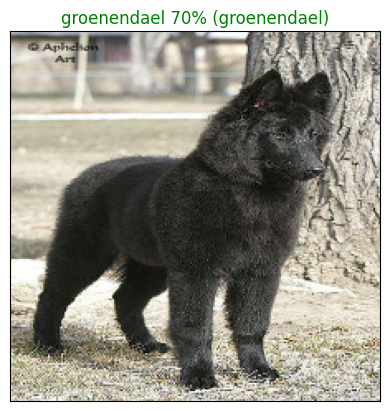

In [67]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities = predictions,
          labels = val_labels,
          images = val_images,
          n = 45)

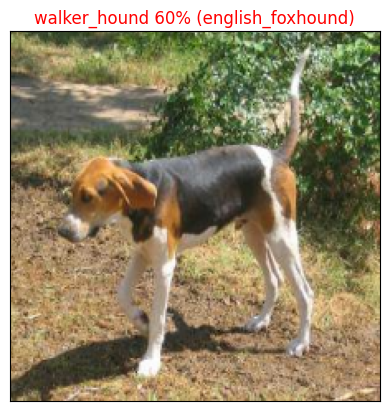

In [68]:
# View an example of wrong prediction
plot_pred(prediction_probabilities = predictions,
          labels = val_labels,
          images = val_images,
          n = 42)

Making functions to help visual your models results are really helpful in understanding how your model is doing.

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

Let's build a function to demonstrate. The function will:
* Take an input of a prediction probabilities array, a ground truth labels array and an integer. ✅
* Find the predicted label using `get_pred_label()`.✅
* Find the top 10:
  * Prediction probabilities indexes ✅
  * Prediction probabilities values ✅
  * Prediction labels ✅
* Plot the top 10 prediction probability values and labels, coloring the true label green. ✅

In [69]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_labels(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                      top_10_pred_values,
                      color = "grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels = top_10_pred_labels,
             rotation = "vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

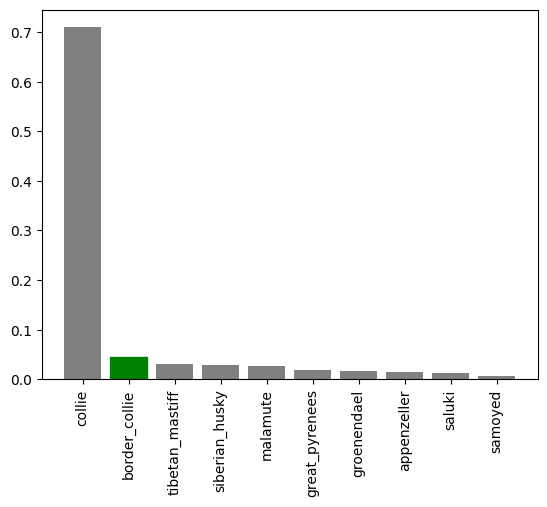

In [70]:
plot_pred_conf(prediction_probabilities = predictions,
               labels = val_labels,
               n = 9)

Now we've got some functions to help us visualize our predictions and evaluate our model, let's check out a few.

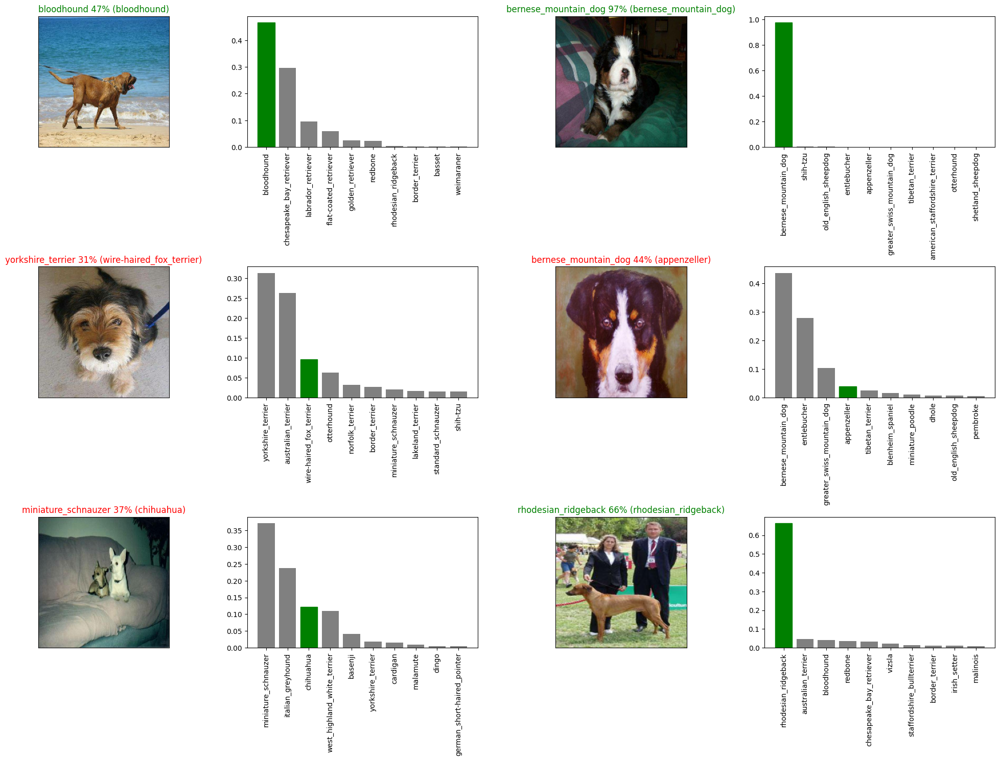

In [71]:
# Let's check a few predictions and their different values
i_multiplier = 100
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize = (5*2*num_cols, 5*num_rows))

for i in range (num_images):

  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities = predictions,
            labels = val_labels,
            images = val_images,
            n = i+i_multiplier)

  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities = predictions,
                 labels = val_labels,
                 n = i+i_multiplier)

plt.tight_layout(h_pad=1.0)
plt.show()

### Saving and reloading a model

After training a model, it's a good idea to save it. Saving it means we can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an [entire saved Keras model is h5](https://www.tensorflow.org/tutorials/keras/save_and_load). So we'll make a function which can take a model as input and utilise the [`save()`](https://www.tensorflow.org/tutorials/keras/save_and_load#savedmodel_format) method to save it as a h5 file to a specified directory.

In [72]:
# Create a function to save a model
def save_model(model, suffix = None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/My Drive/Dog-Vision-Project/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

As the model got saved, we'd like to load it, let's create a function which can take a model path and use the [`tf.keras.models.load_model()`](https://www.tensorflow.org/api_docs/python/tf/keras/models/load_model) function to load it into the notebook.

Because a component from TensorFlow Hub (`hub.KerasLayer`) is being used we'll have to pass this as a parameter to the `custom_objects` parameter.

In [73]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved models from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects = {"KerasLayer": hub.KerasLayer})
  return model

Now we've got functions to save and load a trained model, let's make sure the work!

In [74]:
# Save the model trained on 1000 images
save_model(model, suffix = "1000-images-Adam")

Saving model to: drive/My Drive/Dog-Vision-Project/models/20231231-14391704033594-1000-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/My Drive/Dog-Vision-Project/models/20231231-14391704033594-1000-images-Adam.h5'

In [75]:
# Load the model trained on 1000 images
model_1000_images = load_model('drive/My Drive/Dog-Vision-Project/models/20231213-15221702480967-1000-images-Adam.h5')

Loading saved models from: drive/My Drive/Dog-Vision-Project/models/20231213-15221702480967-1000-images-Adam.h5


Compare the two models (the original one and loaded one). It can be done so easily using the `evaluate()` method.

In [76]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 64ms/step - loss: 1.3185 - accuracy: 0.6550


[1.318453311920166, 0.6549999713897705]

In [77]:
model_1000_images.evaluate(val_data)

7/7 [==============================] - 1s 65ms/step - loss: 1.2220 - accuracy: 0.6850


[1.2219735383987427, 0.6850000023841858]

### Training a model (on the full data)

Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to `X` and all of the training labels to `y`. Let's check them out.

In [78]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a data batch.

The beautiful thing is, we can use our `create_data_batches()` function from above which also preprocesses our images for us (thank you past us for writing a helpful function 🥹).

In [79]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


The data is in a data batch, all we need now is a model.

And surprise, we've got a function for that too!🥹 Let's use `create_model()` to instantiate another model.

In [80]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


Since we've made a new model instance, `full_model`, we'll need some callbacks too.

In [81]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor = "accuracy",
                                                             patience = 3)

**Note:** Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish. However, thanks to our `full_model_early_stopping` callback, it'll stop before it starts going too long.

Remember, the first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.

In [83]:
# Fit the full model to the full training data
full_model.fit(x = full_data,
               epochs = NUM_EPOCHS,
               callbacks = [full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 698s 2s/step - loss: 0.5811 - accuracy: 0.8319
Epoch 2/100
320/320 [==============================] - 31s 97ms/step - loss: 0.3098 - accuracy: 0.9079
Epoch 3/100
320/320 [==============================] - 26s 82ms/step - loss: 0.1892 - accuracy: 0.9521
Epoch 4/100
320/320 [==============================] - 26s 80ms/step - loss: 0.1273 - accuracy: 0.9716
Epoch 5/100
320/320 [==============================] - 25s 78ms/step - loss: 0.0895 - accuracy: 0.9833
Epoch 6/100
320/320 [==============================] - 27s 86ms/step - loss: 0.0663 - accuracy: 0.9907
Epoch 7/100
320/320 [==============================] - 27s 84ms/step - loss: 0.0513 - accuracy: 0.9942
Epoch 8/100
320/320 [==============================] - 26s 82ms/step - loss: 0.0422 - accuracy: 0.9952
Epoch 9/100
320/320 [==============================] - 27s 84ms/step - loss: 0.0339 - accuracy: 0.9965
Epoch 10/100
320/320 [==============================] - 26s 81ms/step - lo

In [84]:
%tensorboard --logdir drive/My\ Drive/Dog-Vision-Project/logs

<IPython.core.display.Javascript object>

#### Saving and reloading the full model

Even on a GPU, this full model took a while to train. So it's a good idea to save it.

We can do so using our `save_model()` function.

**Challenge:** It may be a good idea to incorporate the `save_model()` function into a `train_model()` function. Or look into setting up a [checkpoint callback](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ModelCheckpoint).

In [85]:
# Save model to file
save_model(full_model, suffix = "all-images-Adam")

Saving model to: drive/My Drive/Dog-Vision-Project/models/20231231-15201704036058-all-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/My Drive/Dog-Vision-Project/models/20231231-15201704036058-all-images-Adam.h5'

In [86]:
# Load in the full model
loaded_full_model = load_model("drive/My Drive/Dog-Vision-Project/models/20231213-16531702486412-all-images-Adam.h5")

Loading saved models from: drive/My Drive/Dog-Vision-Project/models/20231213-16531702486412-all-images-Adam.h5


#### Making predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data, we'll:
* Get the test image filenames. ✅
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since there are no labels with the test images). ✅
* Make a predictions array by passing the test data batches to the `predict()` function. ✅

In [87]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "drive/My Drive/Dog-Vision-Project/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

In [88]:
test_filenames[:10]

['drive/My Drive/Dog-Vision-Project/test/dcd3cfe0cd6d363a3ed21639c434c8d3.jpg',
 'drive/My Drive/Dog-Vision-Project/test/de4223b8c5ca7b80d34d1cd2b5e62351.jpg',
 'drive/My Drive/Dog-Vision-Project/test/df01edf92d38b334f78bd85460304801.jpg',
 'drive/My Drive/Dog-Vision-Project/test/df2b5cee4b3d8a3cb893b668df16d572.jpg',
 'drive/My Drive/Dog-Vision-Project/test/e1f7ec4bd372612f53411026aaabf233.jpg',
 'drive/My Drive/Dog-Vision-Project/test/e22127411f6347464f3e91a775bd0245.jpg',
 'drive/My Drive/Dog-Vision-Project/test/e743bea73da2c0dab99ccdbc697b1ac8.jpg',
 'drive/My Drive/Dog-Vision-Project/test/e2b6d4957b62934bd831c3a1b65e2ebb.jpg',
 'drive/My Drive/Dog-Vision-Project/test/e6223aba45a94c9ac349967ed946d0f7.jpg',
 'drive/My Drive/Dog-Vision-Project/test/e699b20911a55abda3558c5bcd37443d.jpg']

In [89]:
# How many test images are there?
len(test_filenames)

10357

In [90]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data = True)

Creating test data batches...


**Note:** Since there are 10,000+ test images, making predictions could take a while, even on a GPU. So beware running the cell below may take up to an hour.

In [91]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose = 1)

324/324 [==============================] - 168s 501ms/step


In [92]:
# Save predictions (NumPy array) to csv file (for access later)
np.savetxt("drive/My Drive/Dog-Vision-Project/preds_array.csv", test_predictions, delimiter = ',')

In [93]:
# Load predictions (NumPy array) from csv file
test_predictions = np.loadtxt("drive/My Drive/Dog-Vision-Project/preds_array.csv", delimiter = ',')

In [94]:
# Check out the test predictions
test_predictions[:10]

array([[9.52224966e-09, 5.71068800e-13, 6.35306563e-09, ...,
        1.83815654e-11, 1.59860448e-07, 4.85403440e-10],
       [6.57008692e-12, 1.52366619e-10, 1.56388478e-06, ...,
        1.37751140e-05, 4.72934698e-06, 1.70617062e-11],
       [2.33721971e-06, 5.26472604e-06, 8.98214637e-07, ...,
        2.73384085e-05, 7.59419017e-09, 2.20152829e-09],
       ...,
       [3.06013132e-11, 2.18891305e-08, 9.44795422e-11, ...,
        2.93649971e-09, 9.56694862e-11, 2.91408508e-10],
       [5.25712132e-08, 1.15833518e-06, 3.29940590e-08, ...,
        9.93130243e-07, 9.99831329e-10, 2.41116815e-08],
       [4.18377572e-12, 2.88416062e-11, 2.15179298e-11, ...,
        3.20854063e-08, 1.50938263e-07, 1.25028066e-09]])

In [95]:
test_predictions.shape

(10357, 120)

#### Preparing test dataset predictions for Kaggle

Looking at the [Kaggle sample submission](https://www.kaggle.com/c/dog-breed-identification/overview/evaluation), it looks like they want the models output probabilities each for label along with the image ID's.

To get the data in this format, we'll:
*   Create a pandas DataFrame with an ID column as well as a column for each dog breed. ✅
*   Add data to the ID column by extracting the test image ID's from their filepaths. ✅
* Add data (the prediction probabilities) to each of the dog breed columns using the `unique_breeds` list and the `test_predictions` list. ✅
* Export the DataFrame as a CSV to submit it to Kaggle. ✅


In [96]:
# Create pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns = ["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [97]:
# Append test image ID's to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df["id"] = test_ids
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,dcd3cfe0cd6d363a3ed21639c434c8d3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,de4223b8c5ca7b80d34d1cd2b5e62351,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,df01edf92d38b334f78bd85460304801,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,df2b5cee4b3d8a3cb893b668df16d572,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e1f7ec4bd372612f53411026aaabf233,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [98]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,dcd3cfe0cd6d363a3ed21639c434c8d3,9.522250e-09,5.710688e-13,6.353066e-09,3.827799e-10,1.627623e-10,5.484173e-06,1.191935e-06,4.974660e-04,1.540897e-10,...,4.656092e-10,1.498057e-05,1.129666e-10,1.075928e-07,1.051861e-10,1.932952e-08,5.076688e-07,1.838157e-11,1.598604e-07,4.854034e-10
1,de4223b8c5ca7b80d34d1cd2b5e62351,6.570087e-12,1.523666e-10,1.563885e-06,1.428289e-11,4.473105e-10,5.352057e-09,8.097026e-07,2.970218e-04,1.499786e-11,...,1.093028e-08,3.784111e-05,2.026563e-09,1.147606e-09,1.444961e-09,4.670130e-10,7.850690e-11,1.377511e-05,4.729347e-06,1.706171e-11
2,df01edf92d38b334f78bd85460304801,2.337220e-06,5.264726e-06,8.982146e-07,1.975043e-03,5.091686e-07,2.908692e-08,5.836199e-09,1.176384e-11,3.556360e-09,...,1.011828e-04,1.169425e-10,4.277666e-08,2.168647e-06,2.320038e-08,1.923320e-08,4.013778e-11,2.733841e-05,7.594190e-09,2.201528e-09
3,df2b5cee4b3d8a3cb893b668df16d572,3.826959e-08,1.632809e-09,4.027992e-11,2.883703e-12,2.445928e-13,5.078818e-13,7.774627e-13,8.063808e-12,1.293101e-12,...,2.930670e-07,8.698302e-10,1.018088e-12,7.145096e-15,9.394568e-13,2.211154e-13,7.239735e-12,2.515511e-10,3.322034e-09,2.042957e-08
4,e1f7ec4bd372612f53411026aaabf233,1.160260e-10,4.612900e-10,8.522448e-12,4.987553e-14,1.286964e-09,3.806528e-11,1.536879e-12,8.289845e-09,4.440545e-13,...,9.783846e-12,8.314647e-12,5.363087e-13,7.394794e-11,1.516601e-10,2.382719e-11,2.190893e-08,1.418933e-14,4.383450e-12,4.741172e-14


Let's now export our predictions DataFrame to CSV so we can submit it to Kaggle.

In [99]:
preds_df.to_csv("drive/My Drive/Dog-Vision-Project/full_model_predictions_submission_1_mobilenetV2.csv",
                index = False)

### Making predictions on custom images

It's great being able to make predictions on a test dataset already provided for us.

But how could we use our model on our own images?

The premise remains, if we want to make predictions on our own custom images, we have to pass them to the model in the same format the model was trained on.

To do so, we'll:
* Get the filepaths of our own images.
* Turn the filepaths into data batches using `create_data_batches()`. And since our custom images won't have labels, we set the `test_data` parameter to `True`.
* Pass the custom image data batch to our model's `predict()` method.
* Convert the prediction output probabilities to prediction labels.
* Compare the predicted labels to the custom images.

**Note:** To make predictions on custom images, I've uploaded pictures of my own to a directory located at `drive/My Drive/Data/dogs/` (as seen in the cell below). In order to make predictions on your own images, you will have to do something similar.

In [150]:
# Get custom image filepaths
custom_path = "drive/My Drive/Dog-Vision-Project/my-dog-photos/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]
custom_image_paths

['drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-1.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-2.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-3.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-4.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-5.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-7.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-9.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-8.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-6.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-10.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-13.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-12.jpg',
 'drive/My Drive/Dog-Vision-Project/my-dog-photos/dog-photo-11.jpg']

In [151]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths,
                                  test_data = True)

Creating test data batches...


In [152]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 2s 2s/step


In [153]:
custom_preds.shape

(13, 120)

In [154]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_labels(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['lhasa',
 'pug',
 'golden_retriever',
 'lhasa',
 'siberian_husky',
 'tibetan_mastiff',
 'bluetick',
 'dingo',
 'dingo',
 'pekinese',
 'pomeranian',
 'soft-coated_wheaten_terrier',
 'dingo']

In [155]:
# Get custom images (unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

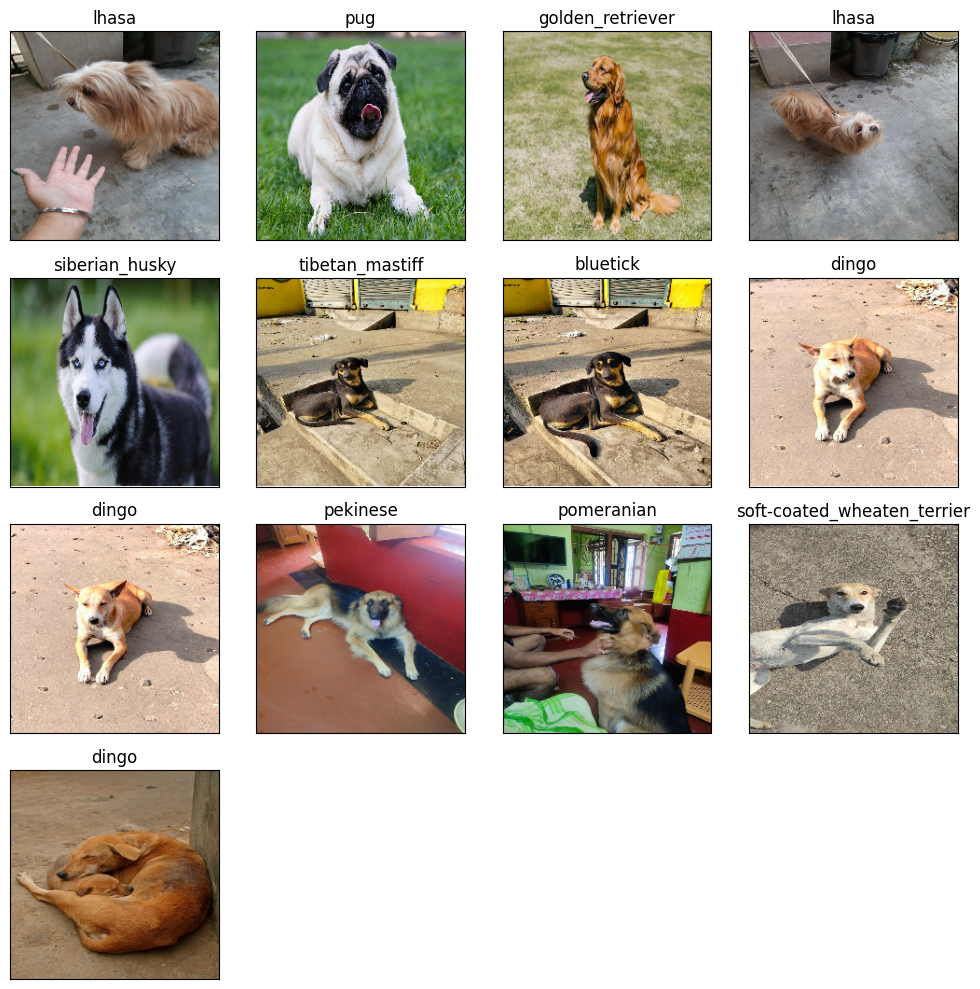

In [157]:
# Determine the number of images
num_images = len(custom_images)

# Calculate the optimal grid shape to fit all images
rows = int(num_images ** 0.5)  # Try a square grid first
cols = num_images // rows
if rows * cols < num_images:  # If it doesn't fit, add a row
    rows += 1

# Create the figure with appropriate size
plt.figure(figsize=(10, 10))  # Adjust figure size as needed

# Iterate through images and create subplots
for i, image in enumerate(custom_images):
    plt.subplot(rows, cols, i+1)  # Use the calculated grid shape
    plt.xticks([])
    plt.yticks([])
    plt.title(custom_pred_labels[i])
    plt.imshow(image)

# Adjust spacing between subplots (optional)
plt.tight_layout()  # Prevent overlapping

# Show the final plot
plt.show()